In [1]:
# Copyright 2020 Fabian Hofmann
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# (2) Conditional Generative Adversarial Network for Video with Untangled Encoded Video Input

Following the first notebook regarding our proposed extension to C-VGAN with untangled latent spaces for background and foreground stream of the generator, this notebook is simply a slight modification to the first one; as with the first C-VGAN with untangled encoded video input, the models here take N frames as input, encode it into two separate latent spaces, before predicting N+1 frames (with the first N frames getting reconstructed).

However in this notebook, the bottleneck of the encoded latent space is widened by factor two - instead of `512` channels in latent space, `1024` are used (for both foreground and background stream). This is required, because due to frame reconstruction, the latent space has to be able to represent `N` that need to be reconstructed instead of simply one (like in original C-VGAN). No further changes (such as 2D convolutional LSTM layers or residual (de-)convolutional layers) were made ot the model.

The rest of the notebook is organized as our first version of modified C-VGAN.

##### Sources
- [VGAN by Vondrick et al](http://www.cs.columbia.edu/~vondrick/tinyvideo/)
- [VOS-GAN by Spampinato et al.](https://arxiv.org/pdf/1803.09092.pdf)
- [Our implementation of VGAN](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.ipynb)
- [Our implementation of C-VGAN](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan_conditional.ipynb)
- [Our modification to C-VGAN](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan_conditional_3d.ipynb)

## Setup

In [2]:
import tensorflow as tf

tf.__version__

'2.1.0'

In [3]:
if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")

Default GPU Device: /device:GPU:0


In [4]:
import numpy as np
import os
import time

from IPython import display
from matplotlib import pyplot as plt

# git+https://github.com/tensorflow/docs
import tensorflow_docs.vis.embed as embed

from src.io_.batch_generator import UniformBatchGenerator, BatchLoader
from src.io_.gif_writer import write_gif_grid
from src.models.vgan import *

In [5]:
base_input_path = "../../data/upCam/preprocessed_128_64/"
base_output_path = "../../output/models/vgan/vgan_conditional_3d_2/"

## Instantiate the batch generator and examples

The discriminator is trained on ~1.5 second (8 frames) long video clips (`train_y`), sampled from the created video dataset, while the conditional generator has to generate videos resembling real ones, while also fitting the first 7 frames of its generated video to its input (`train_x`).

In [6]:
BATCH_SIZE = 64

days = ["00", "01", "02", "03", "04"]
day_paths = [base_input_path + day + "/" for day in days]

uniform_sampler = UniformBatchGenerator(day_paths=day_paths, batch_size=BATCH_SIZE, sample_size=8, subsample_size=7)

train_x, train_y = uniform_sampler[0]
assert np.shape(train_x) == (64, 7, 64, 128, 3) # (samples, frames, height, width, channels)
assert np.shape(train_y) == (64, 8, 64, 128, 3) # (samples, frames, height, width, channels)

To check up on the generator's training progress later (qualitatively, not quantitatively), we once again sample 16 video clips out of the first batch.


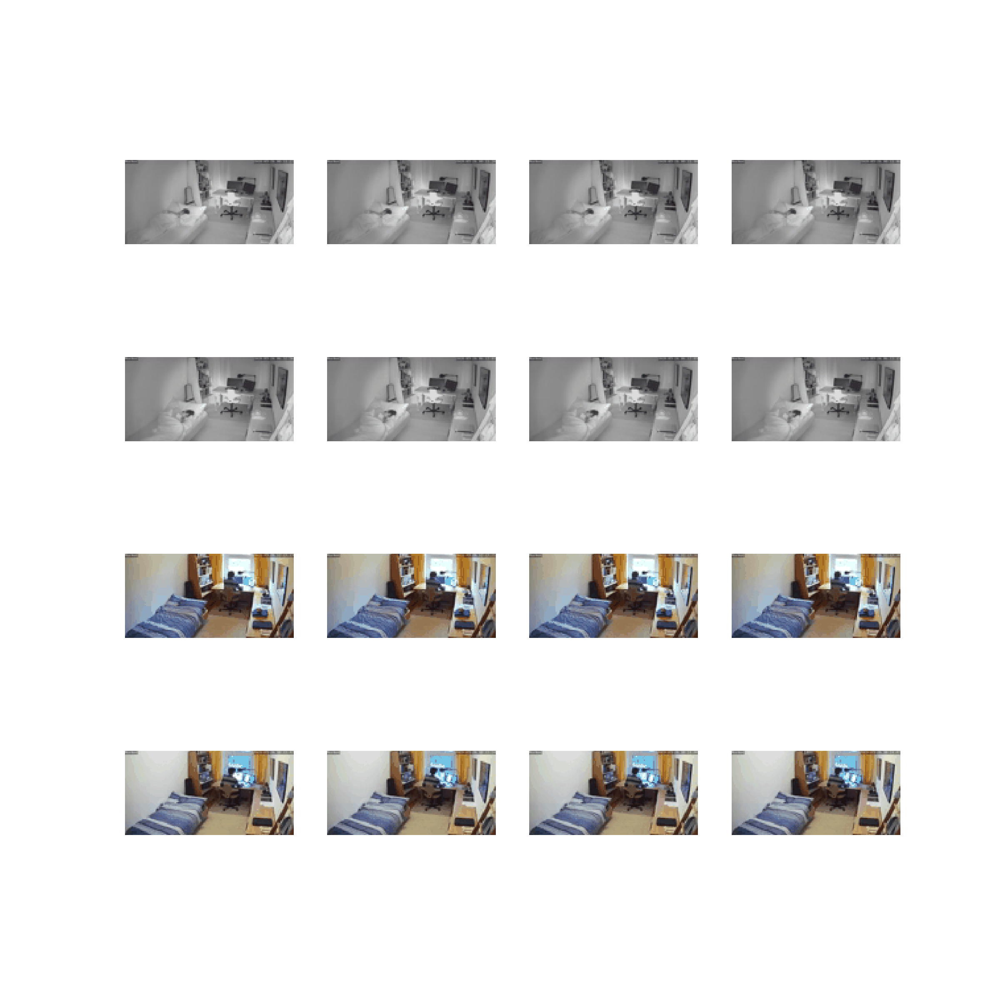

In [7]:
examples_input = train_x[::4]   # will be used as example input later
examples_output = train_y[::4]

image_file_grid = base_output_path + "anim/example_frame_grid.gif"

write_gif_grid(image_file_grid, examples_output, fps=5, dpi=600)
embed.embed_file(image_file_grid)

## Create the models

### The Generator

As already said in the beginning, nothing for the encoders has changed; their latent spaces are still `2x4x1024`, `2x2x4x1024` respectively. However, the latent space is no longer further reduced to `512` channels in the two generator streams, but instead directly upsampled to `4x8x512`, `2x4x8x512` respectively. This removes the first layers from both streams and increases the total number of channels for each layer after the first by factor `2`. All parts of the model are now outsourced [vgan.py](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.py), along with some of the documentation.

In [8]:
def make_generator_model() -> keras.Model:
    inputs: tf.Tensor = keras.Input(shape=(7, 64, 128, 3))

    e_3d = make_encoder_foreground_stream(inputs)
    f, m = make_conditional_foreground_stream(e_3d)

    e_2d = make_encoder_background_stream(inputs)
    b = make_conditional_background_stream(e_2d)

    outputs = make_generator_stream_combiner(f, m, b)

    return keras.Model(inputs=inputs, outputs=outputs, name="c_vgan_generator")

Create the generator model, and check the model summary:

In [9]:
c_vgan_generator = make_generator_model()
c_vgan_generator.summary()

Model: "c_vgan_generator"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 7, 64, 128,  0                                            
__________________________________________________________________________________________________
conv3d (Conv3D)                 (None, 7, 32, 64, 64 5184        input_1[0][0]                    
__________________________________________________________________________________________________
conv3d_5 (Conv3D)               (None, 4, 32, 64, 64 5184        input_1[0][0]                    
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 7, 32, 64, 64 0           conv3d[0][0]                     
___________________________________________________________________________________

Display the input and output shapes of each layer as a DAG in a plotted graph:

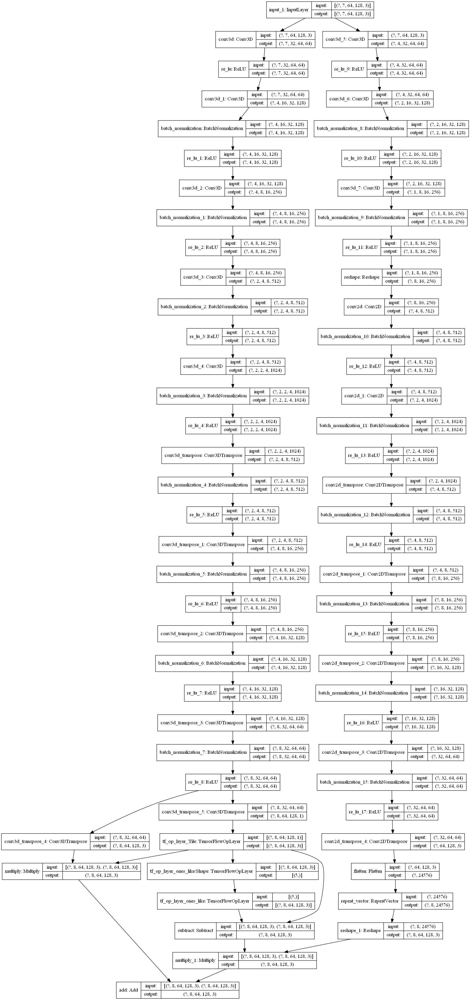

In [10]:
keras.utils.plot_model(c_vgan_generator, base_output_path + "img/c_vgan_generator.png", show_shapes=True)

Use the untrained generator to create a number of test videos from our example inputs:


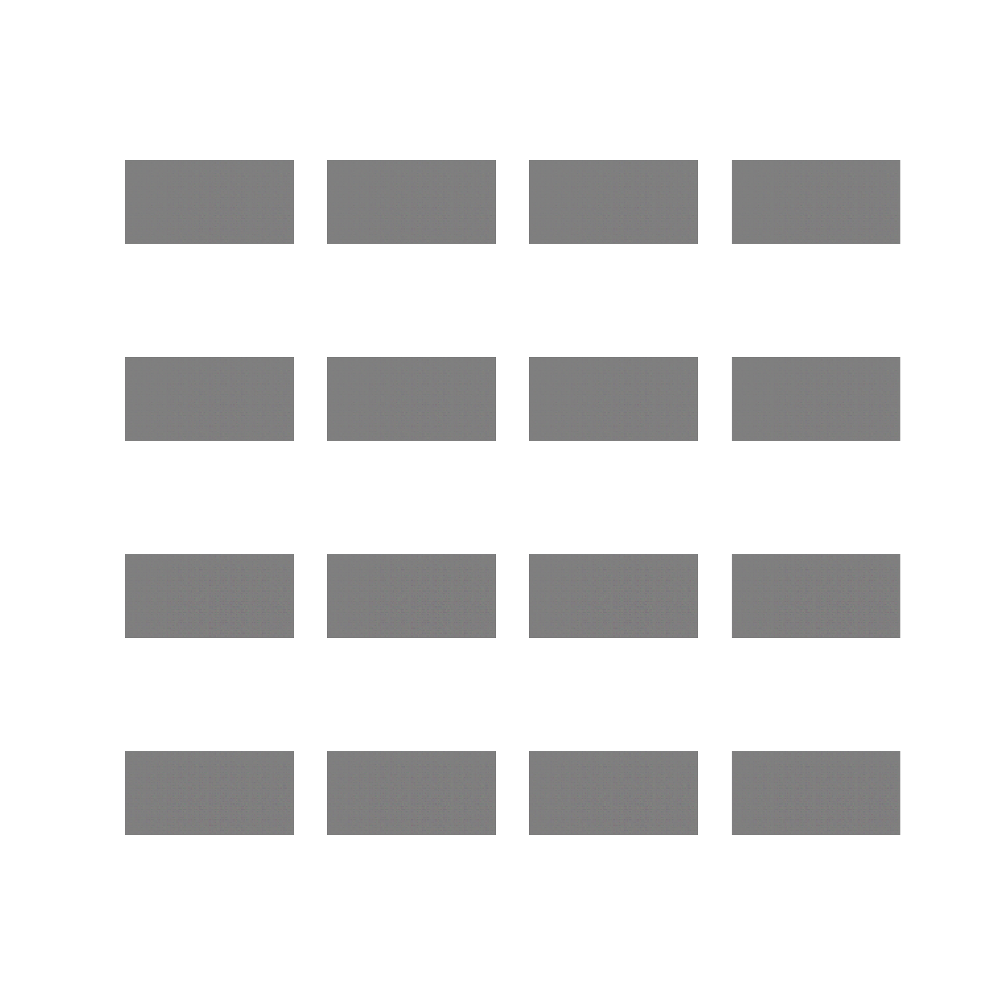

In [11]:
generated_test_videos = c_vgan_generator(examples_input, training=False).numpy()

anim_file_grid = base_output_path + "anim/test_example_grid.gif"
write_gif_grid(anim_file_grid, generated_test_videos, fps=5, dpi=600)
embed.embed_file(anim_file_grid)

### The Discriminator

The discriminator has not changed at all, so we simply call the external [module](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.py). For an extended documentation check the [VGAN notebook](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.ipynb).

Create the discriminator, and test it with the first generated video from generated example batch.

In [12]:
c_vgan_discriminator = make_discriminator_model()

decision = c_vgan_discriminator(generated_test_videos[:1], training=False)
print(decision)

tf.Tensor([[0.02962022]], shape=(1, 1), dtype=float32)


## Define the loss and optimizers

### Cross-Entropy

We do not use an activation function for the final layer in the discriminator model, so we use the binary cross entropy that is more numerical stable, using `from_logits=True`.

In [13]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Discriminator loss

For the discriminator, nothing has changed; it still has to classify real videos as real (ones), and generated ones as fake (zeros):

In [14]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

### Generator loss

The generator's loss function is extended by a reconstruction error for the input frames `x` and the first seven generated frames `g`. This value is weighted by an additional hyperparameter lambda. For now, the parameter is set to `10`, as in our C-VGAN implementation. We once again chose the mean absolute error.

In [15]:
LAMBDA = 10
mean_abs_err = tf.keras.losses.MeanAbsoluteError()

def generator_loss(fake_output, x, g):
    fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    reconstruction_loss = mean_abs_err(x, g) * LAMBDA
    return fake_loss + reconstruction_loss

The optimizers are configured in the same way as in the normal VGAN:

In [16]:
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)

## Save checkpoints

In [17]:
checkpoint_dir = base_output_path + "training_checkpoints/"
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=c_vgan_generator,
                                 discriminator=c_vgan_discriminator)

## Define the training loop

As with C-VGAN, we will not need any seeds for example outputs.

In [18]:
EPOCHS = 10

For each training step, the first 7 frames of a number of real videos (BATCH_SIZE) is used as input for the generator to produce a same number of videos that are each 8 frames long. The discriminator has to then classify these videos. In addition, the corresponding real videos are also fed to the discriminator to be classified. On the results the loss for both models is calculated, and the models are updated accordingly.

In [19]:
@tf.function
def train_step(batch):
    input_frames, input_videos = batch

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_videos = c_vgan_generator(input_frames, training=True)

        real_output = c_vgan_discriminator(input_videos, training=True)
        fake_output = c_vgan_discriminator(generated_videos, training=True)

        gen_loss = generator_loss(fake_output, input_frames, generated_videos[:,:7])
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, c_vgan_generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, c_vgan_discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, c_vgan_generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, c_vgan_discriminator.trainable_variables))

    return gen_loss, disc_loss

In [20]:
gen_train_loss = []
disc_train_loss = []

def train(epochs):
    # Load latest checkpoint if available
    latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
    checkpoint.restore(latest_checkpoint)
    if latest_checkpoint:
        print("Restored from {}".format(latest_checkpoint))
    else:
        print("Initializing from scratch.")

    for epoch in range(epochs):
        # Init batch loader for this epoch
        batch_loader = BatchLoader(uniform_sampler, max_queue_size=128, no_workers=4)

        # Init storage for losses of current epoch
        gen_epoch_loss = []
        disc_epoch_loss = []

        start = time.time()

        # Train models over the entire batch each epoch
        for _ in range(len(batch_loader)):
            batch = batch_loader.get_batch()
            gen_batch_loss, disc_batch_loss = train_step(batch)
            gen_epoch_loss.append(gen_batch_loss)
            disc_epoch_loss.append(disc_batch_loss)

        # Store loss of epoch for summary after training
        gen_train_loss.append(tf.math.reduce_mean(tf.convert_to_tensor(gen_epoch_loss)))
        disc_train_loss.append(tf.math.reduce_mean(tf.convert_to_tensor(disc_epoch_loss)))

        # Produce this epoch's generated videos from the fixed seed
        display.clear_output(wait=True)
        generate_and_save_videos(c_vgan_generator, epoch + 1, examples_input)

        # Save the model every 2 epochs
        if (epoch + 1) % 2 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        print('Time for epoch {} is {} sec'.format(epoch + 1, time.time() - start))

        # Cleanup
        batch_loader.shutdown_workers()

    # Generate the last epoch's video from the fixed seed
    display.clear_output(wait=True)
    generate_and_save_videos(c_vgan_generator, epochs, examples_input)

## Generate and save videos

In [21]:
anim_file_dir = base_output_path + "anim/train/"

def generate_and_save_videos(model, epoch, test_input):
    predictions = model(test_input, training=False).numpy()

    anim_grid = anim_file_dir + "anim_at_epoch_{:04d}.gif".format(epoch)
    write_gif_grid(anim_grid, predictions, fps=5, dpi=600)

## Train the model

Call the `train()` method defined above to train the generator and discriminator simultaneously. It is important to note however, that generator and discriminator do not overpower each other (else one of them will run into a dead end regarding improvement, causing the other one to be stuck as well).

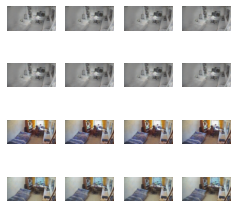

In [22]:
train(EPOCHS)

### Output training losses

In [23]:
epochs_arr = np.arange(EPOCHS)
gen_loss_arr = np.asarray(gen_train_loss)
disc_loss_arr = np.asarray(disc_train_loss)

training_loss = base_output_path + "img/training_loss.png"

plt.plot(epochs_arr, gen_loss_arr, "b", label="gen loss")
plt.plot(epochs_arr, disc_loss_arr, "y", label="disc loss")
plt.xlabel("epochs")
plt.xlabel("loss")
plt.legend(loc="upper right")

plt.savefig(training_loss)
plt.show()

Generator training loss per epoch: 	[<tf.Tensor: shape=(), dtype=float32, numpy=1.516817>, <tf.Tensor: shape=(), dtype=float32, numpy=2.734952>, <tf.Tensor: shape=(), dtype=float32, numpy=3.7335799>, <tf.Tensor: shape=(), dtype=float32, numpy=4.057074>, <tf.Tensor: shape=(), dtype=float32, numpy=4.5664067>, <tf.Tensor: shape=(), dtype=float32, numpy=4.243039>, <tf.Tensor: shape=(), dtype=float32, numpy=4.7606173>, <tf.Tensor: shape=(), dtype=float32, numpy=5.262749>, <tf.Tensor: shape=(), dtype=float32, numpy=5.2200084>, <tf.Tensor: shape=(), dtype=float32, numpy=5.1614017>]
Discriminator train loss per epoch: 	[<tf.Tensor: shape=(), dtype=float32, numpy=1.4480036>, <tf.Tensor: shape=(), dtype=float32, numpy=0.95873445>, <tf.Tensor: shape=(), dtype=float32, numpy=0.47741526>, <tf.Tensor: shape=(), dtype=float32, numpy=0.37735865>, <tf.Tensor: shape=(), dtype=float32, numpy=0.32745874>, <tf.Tensor: shape=(), dtype=float32, numpy=0.38611233>, <tf.Tensor: shape=(), dtype=float32, numpy=0.

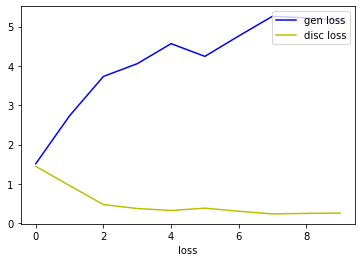

In [24]:
print("Generator training loss per epoch:",
      "\t" + str(gen_loss_arr))
print("Discriminator train loss per epoch:",
      "\t" + str(disc_loss_arr))

## Display any of the generated videos


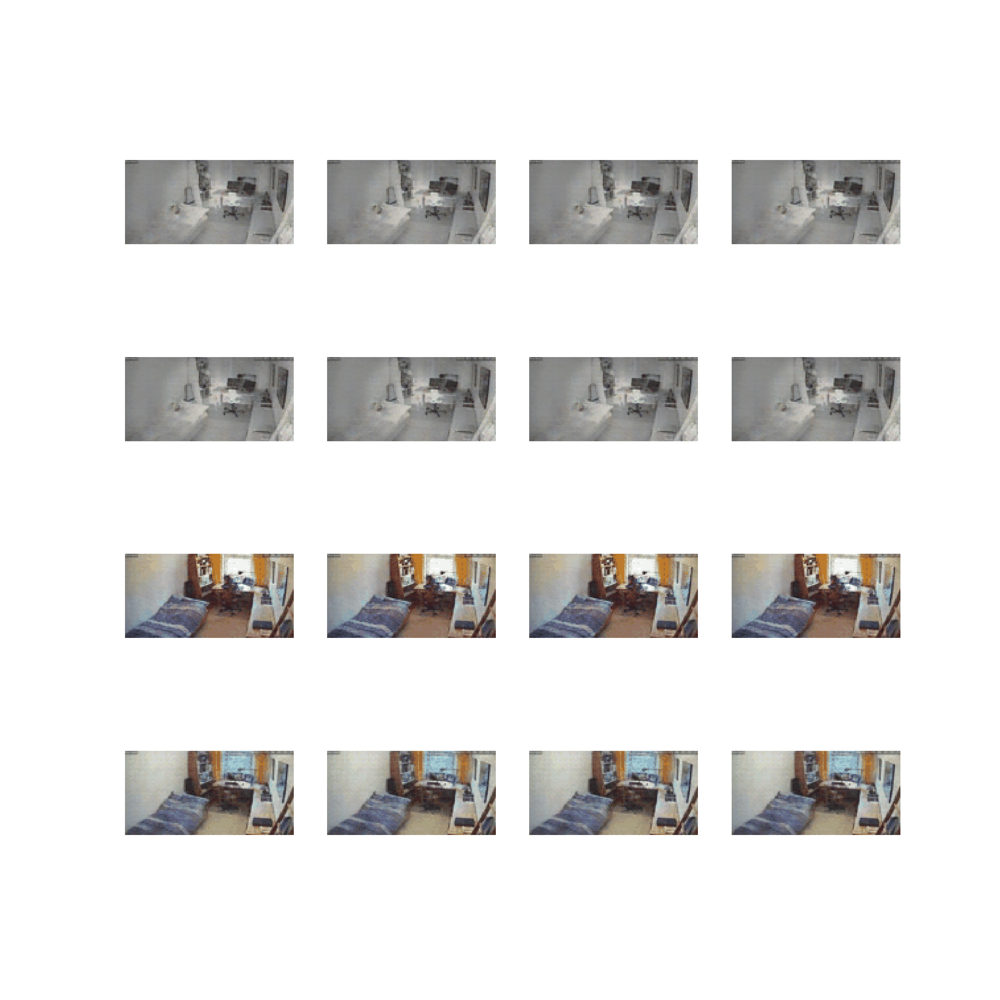

In [25]:
epoch_no = EPOCHS

embed.embed_file(anim_file_dir + "anim_at_epoch_{:04d}.gif".format(epoch_no))